# Description 
This python notebook file produces all the figures that are used in the study "Graupel and increased turbulence observed near small-scale intermittent lightning discharges at the top of intense thunderstorms" by R. van Loon et al. 

To run this file, please install the right python code, install the approriate Python modules and research data. The instructions for this can be found in the README file in the Github repository: https://github.com/reinaartvanloon/LOFARsparkles-radar-researchcode

It is important, that you define the directories (which are computer and user dependend) before you run the rest of the code. The remainder of the code should run without problems. 

Please reach out to the Github repository if you encounter problems.

# General imports and definitions

In [1]:
# PC and user defined variables --> dircetories and file names
'''
Define the following variables, according to the file locations on your computer.
Note that you will need to give the path to your data sources, otherwise it will not work.
'''

# Where to save figures
outdir = "/paht/to/dir/to/save/figures"

# Some directory where you have saved the radar data
# data should be ordered as datapath/LOFAR/21C
RADdata_dirpath = "/path/to/dir/with/radar/data"
LOFARdata_dirpath = "/path/to/dir/with/LOFAR/data"

# Path to ERA5 data, used for advecting the data, and the temperature in the HMC algorithm
advection_reference_filepath = "/path/to/file/ERA5_20210618.grib"

# Wradlib's 2D membership functions for hydrometeor classisification (HMC)
hmc_msf_filepath =  "/path/to/file/msf_cband_v2.nc"

# Path to directory with shapefiles
# Needed to plot borders in the geospatial plots
dirpath_shapefiles_borders = "/path/to/dir/with/shapefiles" 

In [2]:
# Importing modules and functions and configuration objects 
%load_ext autoreload
%autoreload 2
# Python (pip) modules
from cartopy.crs import PlateCarree
import matplotlib.patheffects as pe

# Custom modules
from general import  WindowExtent, PlottingObject
import plot_LOFAR
from plot_LOFAR import ConfigLOFAR, ConfigPlotLOFAR, SparkleParams
from read_RAD import ConfigDataRAD, ConfigMaskRADnearVHF
import plot_RAD_crosssect
from plot_RAD_crosssect import ConfigPlotRADcrossSection
import plot_RAD_multivar
from plot_RAD_multivar import ConfigPlotMultiVarRAD
import stats_sparklesRAD
from stats_sparklesRAD import ConfigPlotSparkleStats


In [3]:
# This needs to stay the same througout all analysis below:

# Parameters to find sparkles, used in LOFAR_plot.cluster_LOFARsparkles
sparkle_params = SparkleParams(
    large_cluster = {"d": 1000, "t": 150, "n": 30},
    sparkle_cluster = {"d": 200, "t": 5, "n": 2},
    alt_windows = [[8000,None]],
    )

# Figure 1: LOFAR image at 19:54:22 UTC

In [4]:
# Configuring the LOFAR data and the plot
plot_extent = WindowExtent(
    x_range=[6.81, 7.15],
    y_range=[53.1, 53.293],
    z_range=[2500,14000],
    t_range=[None,None],
    )

config_LOFAR = ConfigLOFAR(
    LOFAR_file="21C8-all.dat",
    stormcode="21C",
    datapath = LOFARdata_dirpath,
    crs='epsg:28992',
    window_extent=WindowExtent(
        ),
    )

config_plot_LOFAR = ConfigPlotLOFAR(
    VHF_type="all",
    plot_extent = plot_extent,
    outdir=outdir,
    outname="21C8_cellB",
    save=True,
    live_plot= True,
    markersize=0.5,
    dirpath_shapefiles_borders=dirpath_shapefiles_borders
    )

In [5]:
# Adding annotations to the plot
# --- annotation1 ---
annotation1_tz = PlottingObject(
    obj_type='annotation',
    ax_name='axs.tz',
    xy=(120, 10.4),
    text='1',
)

annotation1_xy = PlottingObject(
    obj_type='annotation',
    ax_name='axs.xy',
    xy=(7.06, 53.255),
    text='1',
    kwargs={'transform': PlateCarree()},
)

annotation1_zy = PlottingObject(
    obj_type='annotation',
    ax_name='axs.zy',
    xy=(0.8, 0.88),
    text='1',
    kwargs={'xycoords': 'axes fraction'},
)

# --- annotation2 ---
annotation2_tz = PlottingObject(
    obj_type='annotation',
    ax_name='axs.tz',
    xy=(240, 5.7),
    text='2',
)

annotation2_xy = PlottingObject(
    obj_type='annotation',
    ax_name='axs.xy',
    xy=(6.945, 53.178),
    text='2',
    kwargs={'transform': PlateCarree()},
)

annotation2_xz = PlottingObject(
    obj_type='annotation',
    ax_name='axs.xz',
    xy=(0.4, 0.15),
    text='2',
    kwargs={'xycoords': 'axes fraction'},
)

annotation2_zy = PlottingObject(
    obj_type='annotation',
    ax_name='axs.zy',
    xy=(0.12, 0.4),
    text='2',
    kwargs={'xycoords': 'axes fraction'},
)

# --- annotation3 ---
annotation3_tz = PlottingObject(
    obj_type='annotation',
    ax_name='axs.tz',
    xy=(1100, 6),
    text='3',
)

annotation3_xy = PlottingObject(
    obj_type='annotation',
    ax_name='axs.xy',
    xy=(7.01, 53.125),
    text='3',
    kwargs={'transform': PlateCarree()},
)

annotation3_xz = PlottingObject(
    obj_type='annotation',
    ax_name='axs.xz',
    xy=(0.65, 0.25),
    text='3',
    kwargs={'xycoords': 'axes fraction'},
)

annotation3_zy = PlottingObject(
    obj_type='annotation',
    ax_name='axs.zy',
    xy=(0.3, 0.15),
    text='3',
    kwargs={'xycoords': 'axes fraction'},
)

# --- annotation4 ---
annotation4_tz = PlottingObject(
    obj_type='annotation',
    ax_name='axs.tz',
    xy=(1255, 5),
    text='4',
)

annotation4_xy = PlottingObject(
    obj_type='annotation',
    ax_name='axs.xy',
    xy=(7.04, 53.283),
    text='4',
    kwargs={'transform': PlateCarree()},
)

annotation4_xz = PlottingObject(
    obj_type='annotation',
    ax_name='axs.xz',
    xy=(0.75, 0.15),
    text='4',
    kwargs={'xycoords': 'axes fraction'},
)

annotation4_zy = PlottingObject(
    obj_type='annotation',
    ax_name='axs.zy',
    xy=(0.33, 0.92),
    text='4',
    kwargs={'xycoords': 'axes fraction'},
)

# Update the plotting list
config_plot_LOFAR.list_plotting_objects = [
    annotation1_tz, annotation1_xy, annotation1_zy,
    annotation2_tz, annotation2_xy, annotation2_xz, annotation2_zy,
    annotation3_tz, annotation3_xy, annotation3_xz, annotation3_zy,
    annotation4_tz, annotation4_xy, annotation4_xz, annotation4_zy,
]


LOFAR data already in the right crs.
120780 VHF sources in -67.38372875<t<1422.01131575
120780 VHF sources in 2500<z<14000
LOFAR data already in the right crs.
Transforming window_extent crs: epsg:4326 to epsg:28992
114307 VHF sources in 250295.0598858568<x<272538.9047894262
82569 VHF sources in 569073.2862239545<y<591050.7426376936
Transforming window_extent crs: epsg:4326 to epsg:28992
Plotting annotation in axis axs.tz.
Plotting annotation in axis axs.xy.
Plotting annotation in axis axs.zy.
Plotting annotation in axis axs.tz.
Plotting annotation in axis axs.xy.
Plotting annotation in axis axs.xz.
Plotting annotation in axis axs.zy.
Plotting annotation in axis axs.tz.
Plotting annotation in axis axs.xy.
Plotting annotation in axis axs.xz.
Plotting annotation in axis axs.zy.
Plotting annotation in axis axs.tz.
Plotting annotation in axis axs.xy.
Plotting annotation in axis axs.xz.
Plotting annotation in axis axs.zy.


/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/.venv/lib/python3.12/site-packages/cartopy/mpl/feature_artist.py:172: UserWarning: Unable to determine extent. Defaulting to global.
  warnings.warn('Unable to determine extent. Defaulting to global.')


File is saved to: /home/reinaart/sparkles/article_figs_test/21C8_cellB.png


/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/.venv/lib/python3.12/site-packages/cartopy/mpl/feature_artist.py:172: UserWarning: Unable to determine extent. Defaulting to global.
  warnings.warn('Unable to determine extent. Defaulting to global.')
/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/.venv/lib/python3.12/site-packages/cartopy/mpl/feature_artist.py:172: UserWarning: Unable to determine extent. Defaulting to global.
  warnings.warn('Unable to determine extent. Defaulting to global.')


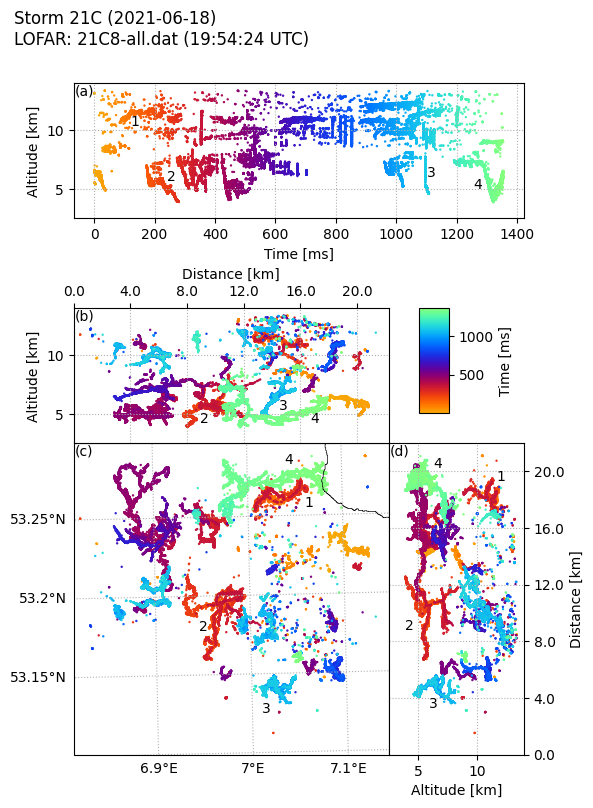

In [6]:
# Plotting
LOFARdata = plot_LOFAR.main(
    config_LOFAR = config_LOFAR, 
    config_plot = config_plot_LOFAR)

# Figure 2: LOFAR image with sparkle selection 

In [7]:
# Configuring the LOFAR data and the plot
plot_extent = WindowExtent(
    x_range=[7.056, 7.072],
    y_range=[53.165, 53.176],
    z_range=[12400,13000],
    t_range=[None,None],
    )

config_LOFAR = ConfigLOFAR(
    LOFAR_file="21C8-all.dat",
    stormcode="21C",
    sparkle_params = sparkle_params,
    datapath = LOFARdata_dirpath,
    crs='epsg:28992',
    window_extent=WindowExtent(
        ),
    )

config_plot_LOFAR = ConfigPlotLOFAR(
    VHF_type="sparkles&otherVHF",
    plot_extent = plot_extent,
    outdir=outdir,
    outname="21C8_cellB_sparkleZoom",
    dirpath_shapefiles_borders=dirpath_shapefiles_borders,
    save=True,
    live_plot= True,
    markersize=2,
    )

LOFAR data already in the right crs.
Large-scale clustering with parameters: d=1000 m, t=150 ms, n=30
Sparkle-scale clustering with parameters: d=200 m, t=5 ms, n=2
Filtering altitude variable on [8000, None].
No time window specified, so not filtering on this variable.
No xy_polygons specified, so not filtering for polygons.
120780 VHF sources in -67.38372875<t<1422.01131575
419 VHF sources in 12400<z<13000
LOFAR data already in the right crs.
Transforming window_extent crs: epsg:4326 to epsg:28992
150 VHF sources in 266602.08805219363<x<267643.34047003096
125 VHF sources in 576658.898562117<y<577907.7341982037
Transforming window_extent crs: epsg:4326 to epsg:28992


/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/.venv/lib/python3.12/site-packages/cartopy/mpl/feature_artist.py:172: UserWarning: Unable to determine extent. Defaulting to global.
  warnings.warn('Unable to determine extent. Defaulting to global.')


File is saved to: /home/reinaart/sparkles/article_figs_test/21C8_cellB_sparkleZoom.png


/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/.venv/lib/python3.12/site-packages/cartopy/mpl/feature_artist.py:172: UserWarning: Unable to determine extent. Defaulting to global.
  warnings.warn('Unable to determine extent. Defaulting to global.')
/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/.venv/lib/python3.12/site-packages/cartopy/mpl/feature_artist.py:172: UserWarning: Unable to determine extent. Defaulting to global.
  warnings.warn('Unable to determine extent. Defaulting to global.')


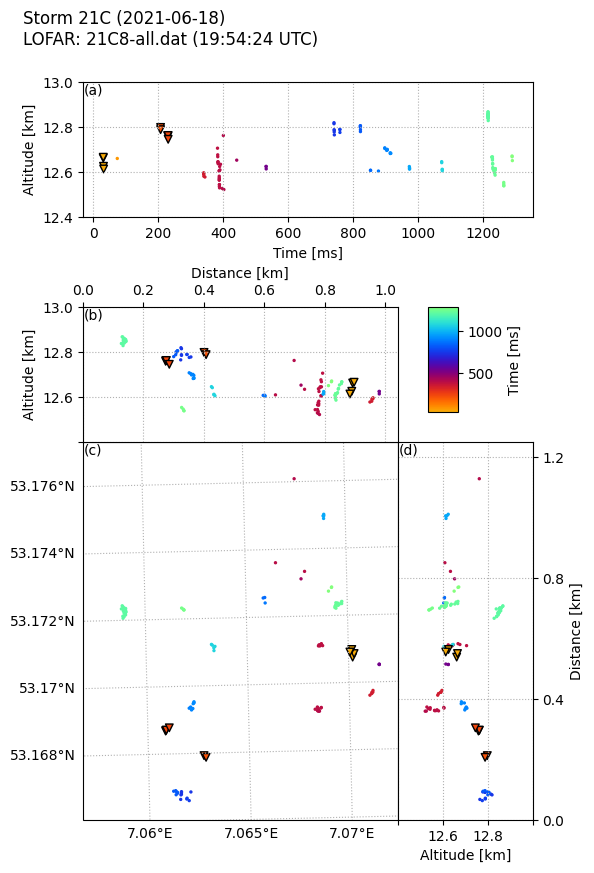

In [8]:
# Plotting
LOFARdata = plot_LOFAR.main(
    config_LOFAR = config_LOFAR, 
    config_plot = config_plot_LOFAR)

# Figure 3: Overview of the storm and lightning

In [9]:
## Importing modules and functions
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd
import gc
import matplotlib.colors as mcolors
import numpy as np
from matplotlib.gridspec import GridSpec
import matplotlib.ticker as mticker


# Custom funtions
from read_RAD import ConfigDataRAD, ConfigMaskRADnearVHF, get_data_RADandLOFAR, add_mask_RADnearVHF
from general import   outpath_gen, getCmap, WindowExtent, plot_borders

In [10]:
## Configuring the plot, LOFAR data, and RADAR data
LOFARfile_list = [
    "21C1eCt-all.dat",
    "21C2en-all.dat",
    "21C3e-all.dat",
    "21C4e-all.dat",
    "21C5e-all.dat",
    "21C6er-all.dat",
    "21C7-all.dat",
    "21C8-all.dat",
    "21C9-all.dat",
    ]

plot_extent = WindowExtent(
    x_range=[5,8],
    y_range=[52.2,54],
    )

config_data_RAD = ConfigDataRAD(
    RADdata_dirpath, 
    stormcode="21C", 
    VHFtype="sparkles&otherVHF", 
    RADstation="asb", 
    RADvars=["dbzh"],
    advection_reference_filepath=advection_reference_filepath, 
    temp_reference_filepath=advection_reference_filepath,
    hmc_msf_filepath=hmc_msf_filepath,
    epsg=28992
    )

# Using these parameters, radar data is marked near sparkles and other VHF sources
config_mask_RADnearVHF = ConfigMaskRADnearVHF(
    RADnearVHF_radius = 2000, # Max distance between radar and VHF data to be matched
    RADalt_threshold=0, # Minimum altitude [meter] for radar data to be considered
    RADdbzh_threshold=0, # Minimum dbzh value for radar data to be considered,
    sparkle_selection_dimension = 'horizontal',
    otherVHF_selection_dimension = 'horizontal',
    )

In [11]:
# Define annotations for the plot
annotation_dict = {
    "21C1eCt-all.dat":{
        "A":[6.85,52.75],
        "A'":[6.45,53.02],
        "D":[5.3,53.32],
        "E":[5.4,52.45],
        },
    "21C2en-all.dat":{
        "A":[6.95,53],
        "A'":[6.5,53.2],
        "D":[5.35,53.5],
        "E":[5.7,52.7],
        },
    "21C3e-all.dat":{
        "A":[7.,53.15],
        "A'":[6.65,53.3],
        "B":[6.8,52.5],
        "D":[5.4,53.75],
        "E":[5.65,52.8],
        },
    "21C4e-all.dat":{
        "A":[7.03,53.25],
        "A'":[6.65,53.38],
        "B":[6.9,52.6],
        "C":[6.3,52.3],
        "D":[5.33,53.75],
        "E":[5.7,52.9],
        },
    "21C5e-all.dat":{
        "A":[7.13,53.35],
        "B":[6.95,52.8],
        "C":[6.4,52.35],
        "D":[5.5,53.85],
        "E":[5.8,53.1],
        },
    "21C6er-all.dat":{
        "A":[7.2,53.4],
        "B":[7,53],
        "C":[6.25,52.7],
        "E":[6,53.25],
        },
    "21C7-all.dat":{
        "A":[7.25, 53.47],
        "B":[7.12, 53.17],
        "C":[6.3, 52.8],
        "E":[6.1, 53.45],
        },
    "21C8-all.dat":{
        "A":[7.33, 53.55],
        "B":[7.2, 53.25],
        "C":[6.42, 53.1],
        "E":[6.3, 53.55],
        },
    "21C9-all.dat":{
        "A":[7.48, 53.72],
        "B":[7.4, 53.42],
        "C":[6.48, 53.25],
        "E":[6.4, 53.7],
        },
    }

In [12]:
# Load data, this takes a while
data_dict = {}

for LOFAR_file in LOFARfile_list:
    print(f"LOFAR file: {LOFAR_file}")
    config_LOFAR = ConfigLOFAR(
        stormcode="21C", 
        LOFAR_file=LOFAR_file,
        datapath = LOFARdata_dirpath,
        sparkle_params = sparkle_params,
        max_distance = None, # radial distance from LOFAR superterm [meter]
        )

    data_i = get_data_RADandLOFAR(
        config = config_data_RAD,
        config_LOFAR = config_LOFAR
        )
    
    data_dict[LOFAR_file] = add_mask_RADnearVHF(
        data_i.RAD,
        data_i.LOFAR,
        config_mask_RADnearVHF,
        )
    
    data_dict['crs'] = data_i.crs
    data_dict['vardata'] = data_i.vardata
    data_dict[f"{LOFAR_file}_dt"] = data_i.LOFAR.dt
    # free up the big objects
    del data_i, config_LOFAR
    gc.collect()    # force Python to reclaim memory

LOFAR file: 21C1eCt-all.dat
Transforming LOFAR to target crs.
Clustering LOFAR sources to get sparkles
Large-scale clustering with parameters: d=1000 m, t=150 ms, n=30
Sparkle-scale clustering with parameters: d=200 m, t=5 ms, n=2
Filtering altitude variable on [8000, None].
No time window specified, so not filtering on this variable.
No xy_polygons specified, so not filtering for polygons.
LOFAR file: 21C2en-all.dat
Transforming LOFAR to target crs.
Clustering LOFAR sources to get sparkles
Large-scale clustering with parameters: d=1000 m, t=150 ms, n=30
Sparkle-scale clustering with parameters: d=200 m, t=5 ms, n=2
Filtering altitude variable on [8000, None].
No time window specified, so not filtering on this variable.
No xy_polygons specified, so not filtering for polygons.
LOFAR file: 21C3e-all.dat
Transforming LOFAR to target crs.
Clustering LOFAR sources to get sparkles
Large-scale clustering with parameters: d=1000 m, t=150 ms, n=30
Sparkle-scale clustering with parameters: d=200

Transforming window_extent crs: epsg:4326 to +proj=aeqd +lat_0=53.564129 +lon_0=6.748317 +x_0=0 +y_0=0 +datum=WGS84
File is saved to: /home/reinaart/sparkles/article_figs_test/dbzh_1.8.png


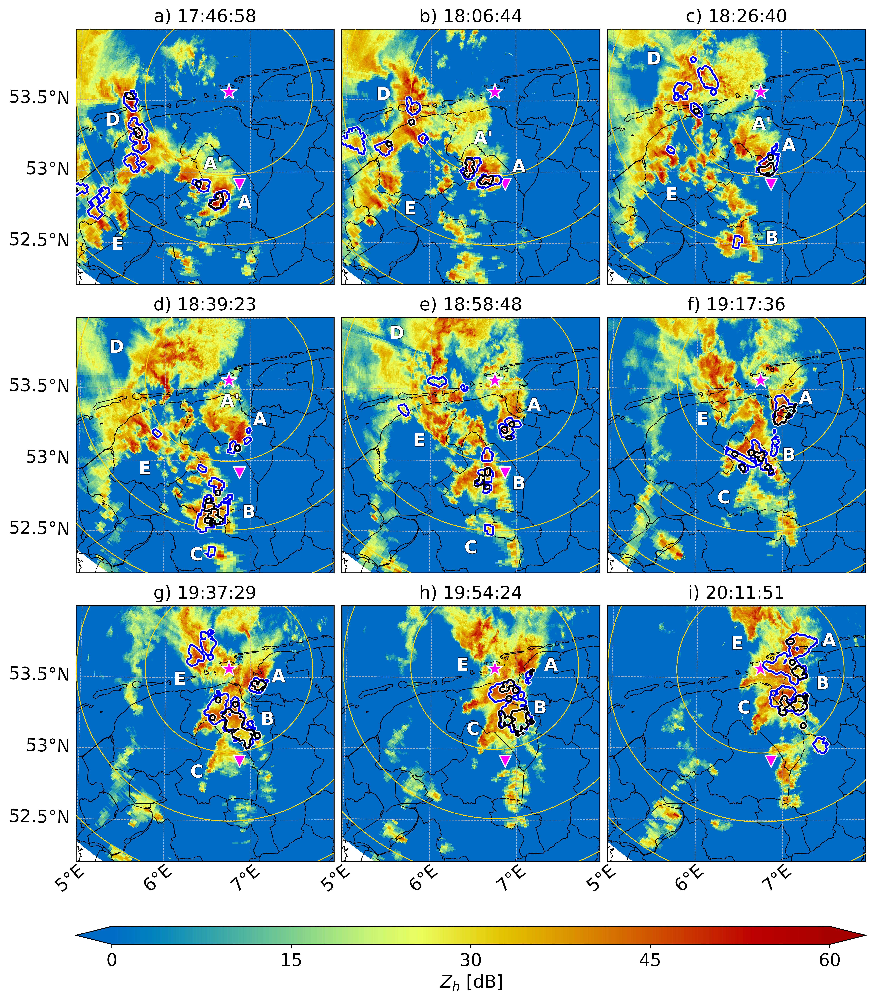

In [13]:
# Plotting
crs = data_dict['crs']
plot_extent = plot_extent.transform_crs(crs_target=crs)

# Eastethics
markersize = 5
color_otherVHFcontour = 'blue'
color_sparklecontour = 'black'
linewidth = 1.5
markersize = 100
alphabet = list(map(chr, range(97, 123)))
plt.rcParams.update({'font.size': 15})
dpi = 600
annotations = True

sweep_angle = 1.8

ncols = 3
nrows = 3

varlist = ['dbzh']

for var in varlist:
    varlib = data_dict['vardata'][var]
    varkey = varlib['ODIM']
    cmap, cmap_norm = getCmap(varlib)

    # Create figure with GridSpec'
    gs = GridSpec(
        nrows + 2, ncols, 
        height_ratios=[10, 10, 10, 0.05, 0.7], 
        width_ratios=[1, 1, 1],
        )
    gs.update(wspace=0.03, hspace=0.2)
    
    fig = plt.figure(dpi=dpi)

    k = 0
    for row in range(nrows):
        if k >= len(data_dict):
            break

        for col in range(ncols):
            LOFAR_file = LOFARfile_list[k]
            data_k = data_dict[LOFAR_file]
            data_k = data_dict[LOFAR_file]
            sweep = data_k.ds.sel(sweep_fixed_angle=sweep_angle, method='nearest')
            # crs = CRSfromPROJ4(f"+proj=aeqd +lat_0={data_k.ds.latitude.values} +lon_0={data_k.ds.longitude.values} +x_0=0 +y_0=0 +datum=WGS84", plot_extent)
            crs = ccrs.AzimuthalEquidistant(
                central_longitude=sweep.longitude.values, 
                central_latitude=sweep.latitude.values,
                )

            # If it's the first plot, create it without sharing axes
            if k == 0:
                ax = fig.add_subplot(gs[row, col], projection=crs)
                shared_ax = ax  # Set this as the axis to share with others
            else:
                # Subsequent plots share x and y axes with the first plot (shared_ax)
                ax = fig.add_subplot(gs[row, col], projection=crs, sharex=shared_ax, sharey=shared_ax)

            ax.set_extent([
                plot_extent.x[0], 
                plot_extent.x[1], 
                plot_extent.y[0], 
                plot_extent.y[1]
                ], 
                crs=crs)

            if var == "HMC":
                sweep_var = sweep["HMC"].argmax("hmc")

                bounds = np.arange(-0.5,sweep.hmc.size, 1)
                ticks = np.arange(0, sweep.hmc.size)
                cmap = cmap
                cmap_norm = mcolors.BoundaryNorm(bounds, cmap.N)

            elif var == "HMC_prob":
                sweep_var = sweep['HMC'].max("hmc")
            else:
                sweep_var = sweep[varkey]

            im = ax.pcolormesh(
                sweep_var.x, sweep_var.y, sweep_var, 
                norm=cmap_norm, cmap=cmap, transform=crs,
                zorder=0)
            
            # Gridlines
            gl = ax.gridlines(
                crs=ccrs.PlateCarree(), draw_labels=True, 
                linestyle='--', linewidth=0.5,
                zorder=1)
            gl.top_labels = False
            gl.right_labels = False
            gl.bottom_labels = False if row + 1 != nrows else True
            gl.left_labels = False if col != 0 else True
            gl.xlabel_style = {
                "rotation":40,
                "ha": "center",
                "va":"bottom",
                }
            gl.ylocator = mticker.MultipleLocator(0.5)
            gl.xlocator = mticker.MultipleLocator(1)


            plot_borders( # With shapefiles in the dirpath
                dirpath_shapefiles_borders,
                ax,
                crs
                )
            # Add borders
            '''
            borders_nl = gpd.read_file(
                data_k.datapath.split("data")[0] + "data/lib/netherlands_shapefiles/NLD_adm1.shp")
            borders_nl['geometry'] = borders_nl['geometry'].to_crs(crs)
            ax.add_geometries(
                borders_nl['geometry'], crs=crs, 
                linewidth=0.5, edgecolor='black', 
                facecolor='none', zorder=2,
                )
            borders_de = gpd.read_file(
                data_k.datapath.split("data")[0] + "data/lib/germany_shapefiles/DEU_adm3.shp")
            borders_de['geometry'] = borders_de['geometry'].to_crs(crs)
            ax.add_geometries(
                borders_de['geometry'], crs=crs, 
                linewidth=0.5, edgecolor='black',
                facecolor='none', zorder=2,
                )
            '''
            
            # Radar location marker
            ax.scatter(
                sweep.longitude.values,
                sweep.latitude.values,
                marker='*',
                transform=ccrs.PlateCarree(),
                s=2*markersize,
                c='fuchsia',
                edgecolor="white",
                zorder = 3
                )
            
            # LOFAR superterp location marker
            ax.scatter(
                6.869711,
                52.915007,
                marker='v',
                transform=ccrs.PlateCarree(),
                s=markersize,
                c='fuchsia',
                edgecolor="white",
                )

            # Use MaxNLocator to determine logical contour levels
            if sweep_angle < 11:
                contour_step = 2
            else:
                contour_step = 4
                
            z_max = sweep_var.z.max().values / 1000 # in km
            contour_levels = np.arange(0, z_max, contour_step)
            alt_contour = ax.contour(
                sweep_var.x, sweep_var.y, 
                sweep_var.z / 1000, levels=contour_levels, 
                linewidths=linewidth / 2,
                zorder=4,
                colors='gold')
            # ax.clabel(
            #     alt_contour, inline=True, fmt='%1.1f km',
            #     zorder=4)

                
            # White contours for emphasis
            ax.contour(
                sweep_var.x, sweep_var.y, 
                np.where(sweep['mask_otherVHF'], 1, 0), 
                colors="white",
                alpha=1,
                linewidths=2*linewidth, 
                levels=[0.5], 
                transform=crs,
                zorder=5
                )
                
            ax.contour(
                sweep_var.x, sweep_var.y, 
                np.where(sweep['mask_sparkles'], 1, 0), 
                colors="white",
                alpha=1,
                linewidths=2*linewidth, 
                levels=[0.5], 
                transform=crs,
                zorder=5
                )
            
            # Different contour colors for disctintion
            ax.contour(
                sweep_var.x, sweep_var.y, 
                np.where(sweep['mask_otherVHF'], 1, 0), 
                colors=color_otherVHFcontour, 
                linewidths=linewidth, 
                # linestyles=[(0, (4, 0.5))],
                levels=[0.5],
                transform=crs,
                zorder=6,
                )
                
            ax.contour(
                sweep_var.x, sweep_var.y, 
                np.where(sweep['mask_sparkles'], 1, 0), 
                colors=color_sparklecontour, 
                linewidths=linewidth, 
                levels=[0.5], 
                # linestyles=[(0, (1, 0.5))],
                transform=crs,
                zorder=6,
                )

            ax.set_title(
                "{}) {}".format(
                    alphabet[k], 
                    data_dict[f"{LOFAR_file}_dt"].strftime("%H:%M:%S")
                    ),
                fontsize=plt.rcParams['font.size'],
                )            
    
            if annotations:
                if LOFAR_file in annotation_dict:
                    for key, item in annotation_dict[LOFAR_file].items():
                        ax.annotate(
                            text = key,
                            xy=item,
                            color="white",
                            path_effects=[pe.withStroke(linewidth=0.8, foreground="black",alpha=0.8)],
                            transform=ccrs.PlateCarree(),
                            weight='semibold',
                            zorder=7
                            )
            k += 1
            
    # Add colorbar below the plots
    cbar_ax = fig.add_subplot(gs[-1, :])
    cbar = fig.colorbar(im, cax=cbar_ax, orientation='horizontal', extend='both')
    cbar.ax.xaxis.set_major_locator(mticker.MaxNLocator(5))
    cbar.ax.xaxis.set_minor_locator(mticker.NullLocator())
    cbar.set_label('{} [{}]'.format(varlib['symbol'], varlib['units']))

    # Reshaping and structuring and sizing
    subpanel_size = 4
    top_margin = 0.0
    bottom_margin = 0.0
    left_margin = 0.0
    right_margin = 0.0
    hspace = 0.
    wspace = 0.0

    aspect_ratio_subplot = ((sweep_var.y.max() - sweep_var.y.min()) / (sweep_var.x.max() - sweep_var.x.min())).values
    fig_width = ncols * subpanel_size + left_margin + right_margin + 2*wspace
    fig_height = (nrows) * subpanel_size * aspect_ratio_subplot + bottom_margin + top_margin + 2*hspace + 2
    fig.set_size_inches(fig_width, fig_height)

    # fig.subplots_adjust(top=1-top_margin,
    #                     bottom=bottom_margin,
    #                     left=left_margin,
    #                     right=1-right_margin,
                        # hspace=hspace,
                        # wspace=wspace,
                        # )

    outname = f"{var}_{sweep_angle}.png"
    outpath = outpath_gen(outdir, outdir, outname)
    fig.savefig(outpath, dpi=dpi)
    print("File is saved to: "+outpath)

# Figure 4: Cross section super cell

In [14]:
# Configure the data and plot --> first configure sparkle_params above
LOFAR_file = "21C6er-all.dat"
image_category = f"cellA_{LOFAR_file[:4]}"

varlist_RAD=[
    "dbzh",
    # "vradh",
    # "wradh",
    # "hmc",
    ]

plot_extent = WindowExtent(
    x_range=[6.8,7.2],
    y_range=[53.22,53.6],
    z_range=[0,14.5e3]
    )

config_plot = ConfigPlotRADcrossSection(
    sweep_angle_list=[
        # 0.5,
        # 1.5, 
        # 2.5, 
        # 3.5, 
        # 4.5,
        5.5,
        # 8, 
        # 12, 
        # 17, 
        # 25,
        ],
    pointA = [6.85,53.4],
    pointB = [7.1,53.272],
    VHFprojection_dist_to_Vplane=50e3,
    varlist_RAD=varlist_RAD,
    plot_extent=plot_extent,
    live_plot=True,
    save=True,
    outdir=f"{outdir}",
    outname=f"{image_category}",
    VHF_type="sparkles",
    markersize=3,
    dirpath_shapefiles_borders=dirpath_shapefiles_borders,
    )

config_data_RAD = ConfigDataRAD(
    RADdata_dirpath, 
    stormcode="21C", 
    RADstation="asb", 
    RADvars=varlist_RAD,
    advection_reference_filepath=advection_reference_filepath, 
    temp_reference_filepath=advection_reference_filepath,
    hmc_msf_filepath=hmc_msf_filepath,
    epsg=28992,
    )

config_LOFAR = ConfigLOFAR(
    stormcode="21C", 
    LOFAR_file=LOFAR_file,
    datapath = LOFARdata_dirpath,
    sparkle_params = sparkle_params,
    max_distance = 100e3, # radial distance from LOFAR superterm [meter]
    )

config_mask_RADnearVHF = ConfigMaskRADnearVHF(
    RADnearVHF_radius = 2000, # Max distance between radar and VHF data to be matched
    RADalt_threshold=8e3, # Minimum altitude [meter] for radar data to be considered
    RADdbzh_threshold=0, # Minimum dbzh value for radar data to be considered
    )

In [15]:
## Add "BWER" annotation and arrow
arrow = PlottingObject(
    obj_type="arrow",
    ax_name = "ax2",
    x = 18e3,
    y = 1e3,
    dx = -2e3,
    dy = 1.2e3,
    kwargs = {
        "facecolor":"white",
        "width":200,
        "edgecolor":"k",
        "linewidth":1,
        }
    )
annotation = PlottingObject(
    obj_type ="annotation",
    ax_name="ax2",
    text="BWER",
    xy = [18.2e3,0.8e3],
    kwargs = {
        "color":"white",
        "weight":"semibold",
        },
    path_effect = [
        pe.Stroke(linewidth=1, foreground="black"),
        pe.Normal()
        ]
    )
config_plot.list_plotting_objects = [arrow,annotation]

Transforming window_extent crs: epsg:4326 to +proj=aeqd +lat_0=53.564129 +lon_0=6.748317 +x_0=0 +y_0=0 +datum=WGS84
Filtering LOFAR data for max distance of 100000.0 meter from superterp.
Transforming LOFAR to target crs.
Clustering LOFAR sources to get sparkles
Large-scale clustering with parameters: d=1000 m, t=150 ms, n=30
Sparkle-scale clustering with parameters: d=200 m, t=5 ms, n=2
Filtering altitude variable on [8000, None].
No time window specified, so not filtering on this variable.
No xy_polygons specified, so not filtering for polygons.
Large-scale clustering with parameters: d=1000 m, t=150 ms, n=30
Sparkle-scale clustering with parameters: d=200 m, t=5 ms, n=2
Filtering altitude variable on [8000, None].
No time window specified, so not filtering on this variable.
No xy_polygons specified, so not filtering for polygons.
20377 VHF sources in 2580.6079<z<14500.0
Transforming LOFAR to target crs.
17844 VHF sources in 3452.210343971363<x<29902.482695634455
17810 VHF sources in

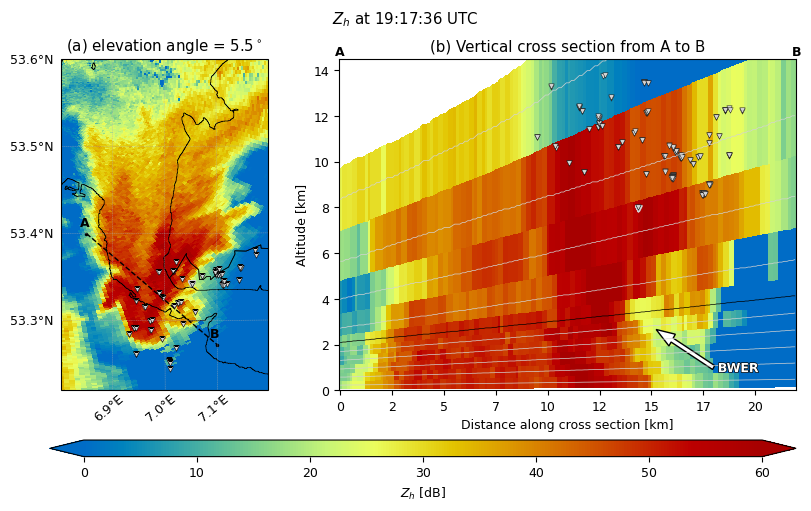

In [16]:
# Plot
plot_RAD_crosssect.main(
    config_plot = config_plot, 
    config_data_RAD = config_data_RAD,
    config_LOFAR = config_LOFAR,
    )

# Figure 5: Topview of bow echo at 19:54:22

In [17]:
# Configure the plot and the data
LOFAR_file = "21C8-all.dat"
image_category = f"cellB_{LOFAR_file[:4]}_bowEcho"
outname = f"{image_category}_Zh"

vars_RAD=[
    "dbzh",
#    "vradh",
#    "wradh",
#    "hmc",
    ]

plot_extent = WindowExtent(
    x_range=[6.35,7.2],
    y_range=[52.95,53.55],
    )

config_plot = ConfigPlotMultiVarRAD(
    sweep_angle_list=[
        1.5, 
#        2.5, 
#        3.5, 
#        4.5,
#        5.5,
#        8, 
#        12, 
#        17, 
#        25,
        ],
    vars_RAD=vars_RAD,
    plot_extent=plot_extent,
    live_plot=True,
    save=True,
    outdir=f"{outdir}",
    outname="topview_vortices",
    dirpath_shapefiles_borders=dirpath_shapefiles_borders,
    )

config_data_RAD = ConfigDataRAD(
    data_dirpath=RADdata_dirpath, 
    stormcode="21C", 
    VHFtype="sparkles&otherVHF", 
    RADstation="asb", 
    RADvars=vars_RAD,
    advection_reference_filepath=advection_reference_filepath, 
    temp_reference_filepath=advection_reference_filepath,
    hmc_msf_filepath=hmc_msf_filepath,
    epsg=28992,
    dt_target="2021-6-18T19:54:24"
    )

config_mask_RADnearVHF = ConfigMaskRADnearVHF(
    RADnearVHF_radius = 2000, # Max distance between radar and VHF data to be matched
    RADalt_threshold=8e3, # Minimum altitude [meter] for radar data to be considered
    RADdbzh_threshold=0, # Minimum dbzh value for radar data to be considered
    )

In [18]:
## Add "BWER" annotation and arrow
arrow1 = PlottingObject(
    obj_type="arrow",
    ax_name = "all",
    x = 6.58,
    y = 53.22,
    dx = 0.055,
    dy = 0.06,
    kwargs = {
         "transform":PlateCarree(),
        "facecolor":"white",
        "width":0.01,
        "edgecolor":"k",
        "linewidth":1,
        }
    )

arrow2 = PlottingObject(
    obj_type="arrow",
    ax_name = "all",
    x = 6.58,
    y = 53.19,
    dx = 0.045,
    dy = -0.06,
    kwargs = {
         "transform":PlateCarree(),
        "facecolor":"white",
        "width":0.01,
        "edgecolor":"k",
        "linewidth":1,
        }
    )

annotation1 = PlottingObject(
    obj_type ="annotation",
    ax_name="all",
    text="Vortices",
    xy = [6.45,53.2],
    kwargs = {
        "transform":PlateCarree(),
        "color":"white",
        "weight":"semibold",
        },
    path_effect = [
        pe.Stroke(linewidth=1, foreground="black"),
        pe.Normal()
        ]
    )

annotation_B = PlottingObject(
    obj_type ="annotation",
    ax_name="all",
    text="B",
    xy = [6.45,53.4],
    kwargs = {
        "transform":PlateCarree(),
        "color":"white",
        "weight":"semibold",
        "size":16,
        },
    path_effect = [
        pe.Stroke(linewidth=1, foreground="black"),
        pe.Normal()
        ]
    )

annotation_C = PlottingObject(
    obj_type ="annotation",
    ax_name="all",
    text="C",
    xy = [6.5,53.1],
    kwargs = {
        "transform":PlateCarree(),
        "color":"white",
        "weight":"semibold",
        "size":16,
        },
    path_effect = [
        pe.Stroke(linewidth=1, foreground="black"),
        pe.Normal()
        ]
    )

ellipse = PlottingObject(
    obj_type ="ellipse",
    ax_name="all",
    xy = [7.1,53.1],
    width = 0.5,
    height = 0.2,
    kwargs = {
        "angle":120,
        "transform":PlateCarree(),
        "facecolor":"none",
        "edgecolor":"white",
        "linewidth":1,
        },
    path_effect = [
        pe.Stroke(linewidth=3, foreground="white"),
        pe.Normal()
        ]
    )

annotation2 = PlottingObject(
    obj_type ="annotation",
    ax_name="all",
    text="Attenuation",
    xy = [7,53],
    kwargs = {
        "transform":PlateCarree(),
        "color":"white",
        "weight":"semibold",
        },
    path_effect = [
        pe.Stroke(linewidth=1, foreground="black"),
        pe.Normal()
        ]
    )

config_plot.list_plotting_objects = [
    arrow1, 
    arrow2,
    annotation1,
    annotation_B,
    annotation_C,
    ellipse, 
    annotation2,
    ]

Transforming window_extent crs: epsg:4326 to +proj=aeqd +lat_0=53.564129 +lon_0=6.748317 +x_0=0 +y_0=0 +datum=WGS84
Transforming window_extent crs: epsg:4326 to +proj=aeqd +lat_0=53.564129 +lon_0=6.748317 +x_0=0 +y_0=0 +datum=WGS84
Plotting topview_vortices_elev1.5.png
Plotting arrow in axis all.
Plotting arrow in axis all.
Plotting annotation in axis all.
Plotting annotation in axis all.
Plotting annotation in axis all.
Plotting ellipse in axis all.
Plotting annotation in axis all.


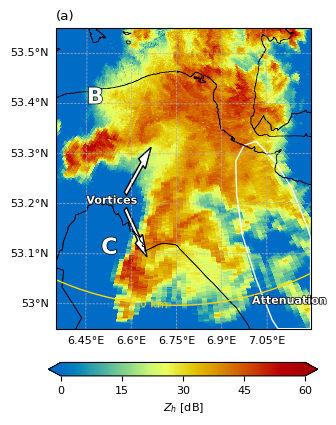

File is saved to: /home/reinaart/sparkles/article_figs_test/topview_vortices_elev1.5.png


In [19]:
# Plotting
config_, im = plot_RAD_multivar.main(
    config_plot = config_plot,
    config_data_RAD = config_data_RAD,
    )

# Figure 6 to 8: Histograms

In [20]:
# Configure the plot and data
LOFARfile_list = [
    "21C1eCt-all.dat",
    "21C2en-all.dat",
    "21C3e-all.dat",
    "21C4e-all.dat",
    "21C5e-all.dat",
    "21C6er-all.dat",
    "21C7-all.dat",
    "21C8-all.dat",
    "21C9-all.dat",
    ]

varlist = [
    "dbzh",
    "wradh", 
    "hmc",
    "vradh",
    "zdr",
    "rhohv",
    ]

config_data_RAD = ConfigDataRAD(
    RADdata_dirpath, 
    stormcode="21C", 
    VHFtype="sparkles&otherVHF", 
    RADstation="asb", 
    RADvars=varlist,
    advection_reference_filepath=advection_reference_filepath, 
    temp_reference_filepath=advection_reference_filepath,
    hmc_msf_filepath=hmc_msf_filepath,
    epsg=28992,
    )

sparkle_params = SparkleParams(
    large_cluster = {"d": 1000, "t": 150, "n": 30},
    sparkle_cluster = {"d": 200, "t": 5, "n": 2},
    alt_windows = [[8000,None]],
    )

config_LOFAR = ConfigLOFAR(
    stormcode="21C", 
    datapath = LOFARdata_dirpath,
    sparkle_params = sparkle_params,
    max_distance = 100e3, # radial distance from LOFAR superterm [meter]
    )

config_mask_RADnearVHF = ConfigMaskRADnearVHF(
    RADnearVHF_radius = 2000, # Max distance between radar and VHF data to be matched
    RADalt_threshold=8e3, # Minimum altitude [meter] for radar data to be considered
    RADdbzh_threshold=0, # Minimum dbzh value for radar data to be considered
    )

config_topview_plots = ConfigPlotMultiVarRAD(
    sweep_angle_list=[1.5, 2.5, 3.5, 5, 8, 12, 17, 25],
    vars_RAD=["dbzh","wradh"],
    plot_extent=WindowExtent(
        x_range=[4,8],
        y_range=[52,54],
        ),
    live_plot=False,
    save=False,
    outdir=f"{outdir}topviews/",
    outname="topview_dbzh_wradh"
    )

config_plots = ConfigPlotSparkleStats(
    LOFARfile_list, 
    varlist = varlist, 
    together=True,
    outdir=outdir,
    save=True, 
    )

Memory usage: 3945.69 MB
21C1eCt-all.dat
Filtering LOFAR data for max distance of 100000.0 meter from superterp.
Transforming LOFAR to target crs.
Clustering LOFAR sources to get sparkles
Large-scale clustering with parameters: d=1000 m, t=150 ms, n=30
Sparkle-scale clustering with parameters: d=200 m, t=5 ms, n=2
Filtering altitude variable on [8000, None].
No time window specified, so not filtering on this variable.
No xy_polygons specified, so not filtering for polygons.
nr of sparkle radar bins: 367
nr of other lightning radar bins: 2517

Memory usage: 3632.90 MB
21C2en-all.dat
Filtering LOFAR data for max distance of 100000.0 meter from superterp.
Transforming LOFAR to target crs.
Clustering LOFAR sources to get sparkles
Large-scale clustering with parameters: d=1000 m, t=150 ms, n=30
Sparkle-scale clustering with parameters: d=200 m, t=5 ms, n=2
Filtering altitude variable on [8000, None].
No time window specified, so not filtering on this variable.
No xy_polygons specified, so n

/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/src/stats_sparklesRAD.py:226: FutureWarning: In a future version of xarray the default value for coords will change from coords='different' to coords='minimal'. This is likely to lead to different results when multiple datasets have matching variables with overlapping values. To opt in to new defaults and get rid of these warnings now use `set_options(use_new_combine_kwarg_defaults=True) or set coords explicitly.
  ds_all = xr.concat([ds_all, ds], dim='radar_vol')


Filtering LOFAR data for max distance of 100000.0 meter from superterp.
Transforming LOFAR to target crs.
Clustering LOFAR sources to get sparkles
Large-scale clustering with parameters: d=1000 m, t=150 ms, n=30
Sparkle-scale clustering with parameters: d=200 m, t=5 ms, n=2
Filtering altitude variable on [8000, None].
No time window specified, so not filtering on this variable.
No xy_polygons specified, so not filtering for polygons.
nr of sparkle radar bins: 192
nr of other lightning radar bins: 2733

Memory usage: 4291.41 MB
21C4e-all.dat
Filtering LOFAR data for max distance of 100000.0 meter from superterp.
Transforming LOFAR to target crs.
Clustering LOFAR sources to get sparkles
Large-scale clustering with parameters: d=1000 m, t=150 ms, n=30
Sparkle-scale clustering with parameters: d=200 m, t=5 ms, n=2
Filtering altitude variable on [8000, None].
No time window specified, so not filtering on this variable.
No xy_polygons specified, so not filtering for polygons.
nr of sparkle r

/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/src/stats_sparklesRAD.py:563: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig(outpath, dpi=400)


File is saved to: /home/reinaart/sparkles/article_figs_test//histograms_Zh-Wrad_1D/aggregatedstats_Zh-Wrad.png


/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/.venv/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.canvas.print_figure(bytes_io, **kw)


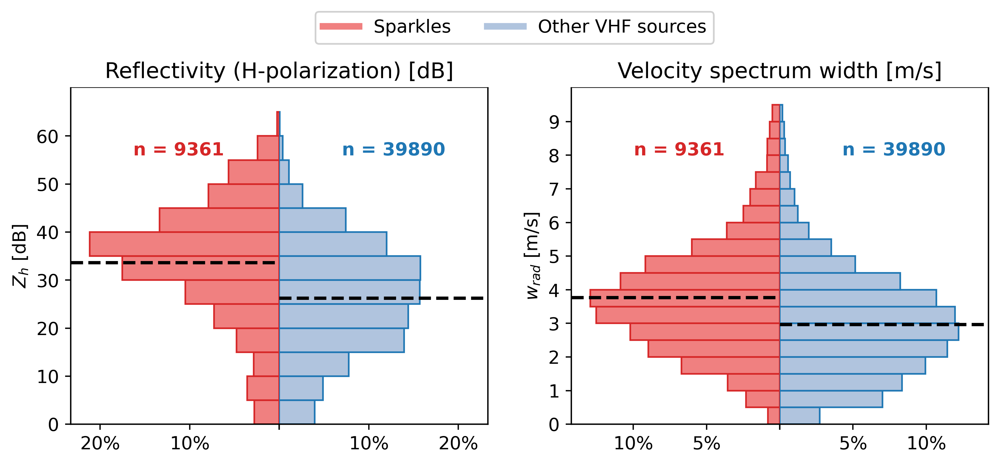

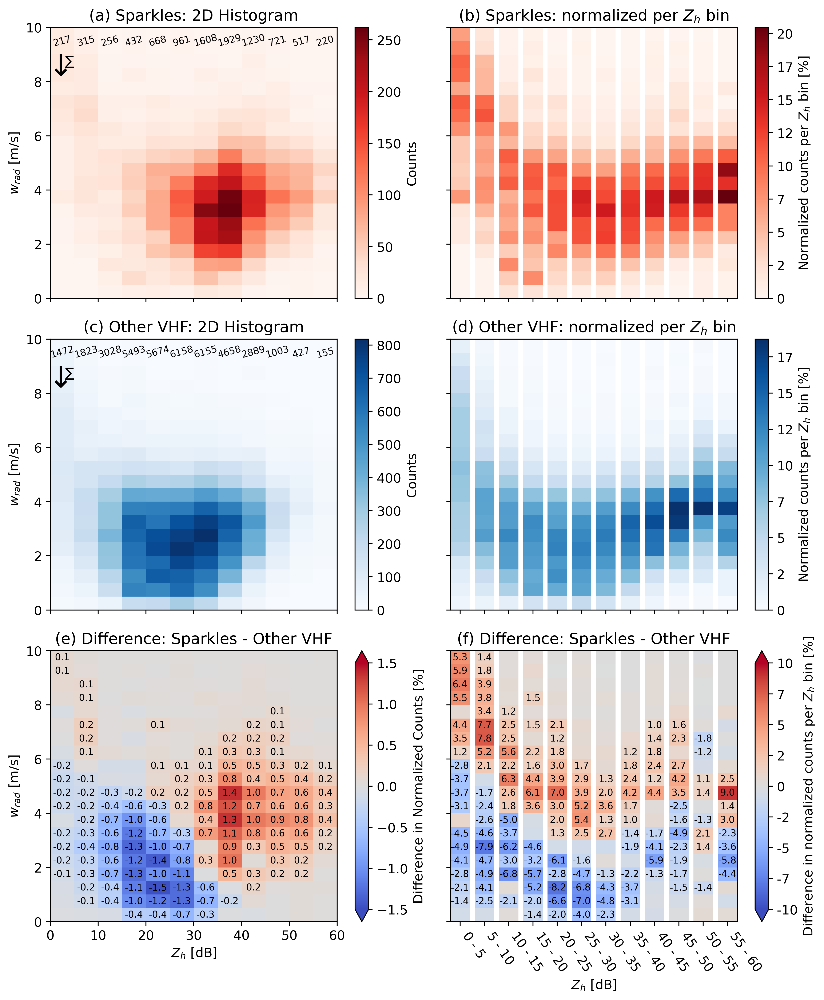

File is saved to: /home/reinaart/sparkles/article_figs_test//histograms_Zh-Wrad_2D/aggregatedstats_Zh-Wrad_2D.png
ax2ticks:  [np.float64(0.0), np.float64(20.0), np.float64(40.0)]


/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/.venv/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.canvas.print_figure(bytes_io, **kw)


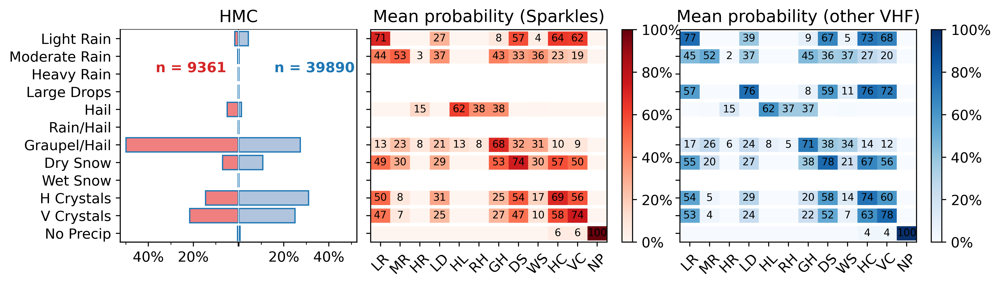

/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/src/stats_sparklesRAD.py:788: UserWarning: There are no gridspecs with layoutgrids. Possibly did not call parent GridSpec with the "figure" keyword
  fig.savefig(outpath, dpi=400)


File is saved to: /home/reinaart/sparkles/article_figs_test//histograms__hmc/aggregatedstats_hmc.png


In [21]:
# Analyzing and plotting --> takes a while...
stats_sparklesRAD.main(
    config_plots, 
    config_data_RAD, 
    sparkle_params, 
    config_LOFAR, 
    config_mask_RADnearVHF,
    config_topview_plots=None,
    )

# Figure 9: multi-variable topviews, cell A 19:17:37, elevation:  17$^\circ$

In [22]:
# Configure plot and data
LOFAR_file = "21C6er-all.dat"
image_category = f"cellA_{LOFAR_file[:4]}"
outname = f"{image_category}_multi-var"

vars_RAD=[
    "dbzh",
    "vradh",
    "wradh",
    "hmc"]

plot_extent = WindowExtent(
    x_range=[6.8,7.24],
    y_range=[53.18,53.5],
    )

config_plot = ConfigPlotMultiVarRAD(
    sweep_angle_list=[
        # 0.5
        # 1.5, 
        # 2.5, 
        # 3.5, 
        # 4.5,
        # 5.5,
        # 8, 
        # 12, 
        17, 
        # 25,
        ],
    vars_RAD=vars_RAD,
    plot_extent=plot_extent,
    live_plot=True,
    save=True,
    outdir=f"{outdir}",
    outname="topview_dbzh_vrad_wrad_hmc",
    dirpath_shapefiles_borders=dirpath_shapefiles_borders,
    )

config_data_RAD = ConfigDataRAD(
    RADdata_dirpath, 
    stormcode="21C", 
    VHFtype="sparkles&otherVHF", 
    RADstation="asb", 
    RADvars=vars_RAD,
    advection_reference_filepath=advection_reference_filepath, 
    temp_reference_filepath=advection_reference_filepath,
    hmc_msf_filepath=hmc_msf_filepath,
    epsg=28992,
    )

config_LOFAR = ConfigLOFAR(
    stormcode="21C", 
    LOFAR_file=LOFAR_file,
    datapath = LOFARdata_dirpath,
    sparkle_params = sparkle_params,
    max_distance = 100e3, # radial distance from LOFAR superterm [meter]
    )

config_mask_RADnearVHF = ConfigMaskRADnearVHF(
    RADnearVHF_radius = 2000, # Max distance between radar and VHF data to be matched
    RADalt_threshold=8e3, # Minimum altitude [meter] for radar data to be considered
    RADdbzh_threshold=0, # Minimum dbzh value for radar data to be considered
    )

In [23]:
# Add arrow2 annotation
arrow1 = PlottingObject(
    obj_type="arrow",
    ax_name = "all",
    x = 7.1,
    y = 53.2,
    dx = 0.015,
    dy = 0.04,
    kwargs = {
         "transform":PlateCarree(),
        "facecolor":"white",
        "width":0.005,
        "edgecolor":"k",
        "linewidth":1,
        }
    )

arrow2 = PlottingObject(
    obj_type="arrow",
    ax_name = "all",
    x = 7.1,
    y = 53.2,
    dx = -0.04,
    dy = 0.012,
    kwargs = {
         "transform":PlateCarree(),
        "facecolor":"white",
        "width":0.005,
        "edgecolor":"k",
        "linewidth":1,
        }
    )

# ellipse_1 = PlottingObject(
#     obj_type ="ellipse",
#     ax_name="all",
#     xy = [6.955,53.27],
#     width = 0.085,
#     height = 0.055,
#     kwargs = {
#         "transform":PlateCarree(),
#         "facecolor":"none",
#         "edgecolor":"white",
#         "linewidth":1,
#         },
#     path_effect = [
#         pe.Stroke(linewidth=2, foreground="white"),
#         pe.Normal()
#         ]
#     )
# ellipse_2 = PlottingObject(
#     obj_type ="ellipse",
#     ax_name="all",
#     xy = [7.04,53.3],
#     width = 0.07,
#     height = 0.05,
#     kwargs = {
#         "transform":PlateCarree(),
#         "facecolor":"none",
#         "edgecolor":"white",
#         "linewidth":1,
#         },
#     path_effect = [
#         pe.Stroke(linewidth=2, foreground="white"),
#         pe.Normal()
#         ]
#     )

config_plot.list_plotting_objects = [
    arrow1,
    arrow2,
    # ellipse_1,
    # ellipse_2,
    ]

Transforming window_extent crs: epsg:4326 to +proj=aeqd +lat_0=53.564129 +lon_0=6.748317 +x_0=0 +y_0=0 +datum=WGS84
Filtering LOFAR data for max distance of 100000.0 meter from superterp.
Transforming LOFAR to target crs.
Clustering LOFAR sources to get sparkles
Large-scale clustering with parameters: d=1000 m, t=150 ms, n=30
Sparkle-scale clustering with parameters: d=200 m, t=5 ms, n=2
Filtering altitude variable on [8000, None].
No time window specified, so not filtering on this variable.
No xy_polygons specified, so not filtering for polygons.
Transforming window_extent crs: epsg:4326 to +proj=aeqd +lat_0=53.564129 +lon_0=6.748317 +x_0=0 +y_0=0 +datum=WGS84
Plotting topview_dbzh_vrad_wrad_hmc_elev17.png
Plotting arrow in axis all.
Plotting arrow in axis all.
Plotting arrow in axis all.
Plotting arrow in axis all.
Plotting arrow in axis all.
Plotting arrow in axis all.
Plotting arrow in axis all.
Plotting arrow in axis all.


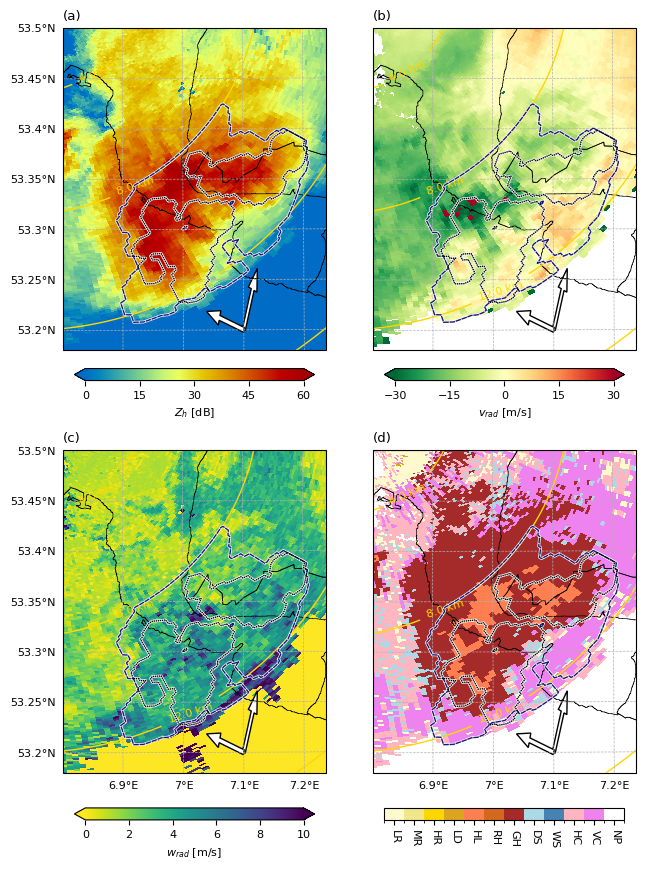

File is saved to: /home/reinaart/sparkles/article_figs_test/topview_dbzh_vrad_wrad_hmc_elev17.png


In [24]:
#%% Plotting
config_, im = plot_RAD_multivar.main(
    config_plot = config_plot,
    config_data_RAD = config_data_RAD,
    config_LOFAR = config_LOFAR,
    config_mask_RADnearVHF = config_mask_RADnearVHF,
    )

# Figure 10: Multi variable, topview cell B at 19:54:24, elevation: 12$^\circ$

In [25]:
# Configure plot and data
# PC and user defined variables
LOFAR_file = "21C8-all.dat"
image_category = f"cellB_{LOFAR_file[:4]}"
outname = f"{image_category}_multi-var"

vars_RAD=[
    "dbzh",
    "vradh",
    "wradh",
    "hmc"]

plot_extent = WindowExtent(
    x_range=[6.7,7.2],
    y_range=[53.08,53.45],
    )

config_plot = ConfigPlotMultiVarRAD(
    sweep_angle_list=[
        # 0.5
        # 1.5, 
        # 2.5, 
        # 3.5, 
        # 4.5,
        # 5.5,
        # 8, 
        12, 
        # 17, 
        # 25,
        ],
    vars_RAD=vars_RAD,
    plot_extent=plot_extent,
    live_plot=True,
    save=True,
    outdir=f"{outdir}",
    outname="topview_dbzh_vrad_wrad_hmc",
    dirpath_shapefiles_borders=dirpath_shapefiles_borders,
)

config_data_RAD = ConfigDataRAD(
    RADdata_dirpath, 
    stormcode="21C", 
    VHFtype="sparkles&otherVHF", 
    RADstation="asb", 
    RADvars=vars_RAD,
    advection_reference_filepath=advection_reference_filepath, 
    temp_reference_filepath=advection_reference_filepath,
    hmc_msf_filepath=hmc_msf_filepath,
    epsg=28992,
    )

config_LOFAR = ConfigLOFAR(
    stormcode="21C", 
    LOFAR_file=LOFAR_file,
    datapath = LOFARdata_dirpath,
    sparkle_params = sparkle_params,
    max_distance = 100e3, # radial distance from LOFAR superterm [meter]
    )

config_mask_RADnearVHF = ConfigMaskRADnearVHF(
    RADnearVHF_radius = 2000, # Max distance between radar and VHF data to be matched
    RADalt_threshold=8e3, # Minimum altitude [meter] for radar data to be considered
    RADdbzh_threshold=0, # Minimum dbzh value for radar data to be considered
    )

In [26]:
# Add ellips and arrow annotations
ellipse = PlottingObject(
    obj_type ="ellipse",
    ax_name="all",
    xy = [7.04,53.195],
    width = 0.08,
    height = 0.05,
    kwargs = {
        "transform":PlateCarree(),
        "facecolor":"none",
        "edgecolor":"white",
        "linewidth":1,
        },
    path_effect = [
        pe.Stroke(linewidth=2, foreground="white"),
        pe.Normal()
        ]
    )

arrow = PlottingObject(
    obj_type="arrow",
    ax_name = "all",
    x = 7.18,
    y = 53.09,
    dx = -0.02,
    dy = 0.01,
    kwargs = {
         "transform":PlateCarree(),
        "facecolor":"white",
        "width":0.005,
        "edgecolor":"k",
        "linewidth":1,
        }
    )

config_plot.list_plotting_objects = [
    ellipse, 
    arrow,
    ]

Transforming window_extent crs: epsg:4326 to +proj=aeqd +lat_0=53.564129 +lon_0=6.748317 +x_0=0 +y_0=0 +datum=WGS84
Filtering LOFAR data for max distance of 100000.0 meter from superterp.
Transforming LOFAR to target crs.
Clustering LOFAR sources to get sparkles
Large-scale clustering with parameters: d=1000 m, t=150 ms, n=30
Sparkle-scale clustering with parameters: d=200 m, t=5 ms, n=2
Filtering altitude variable on [8000, None].
No time window specified, so not filtering on this variable.
No xy_polygons specified, so not filtering for polygons.
Transforming window_extent crs: epsg:4326 to +proj=aeqd +lat_0=53.564129 +lon_0=6.748317 +x_0=0 +y_0=0 +datum=WGS84
Plotting topview_dbzh_vrad_wrad_hmc_elev12.png
Plotting ellipse in axis all.
Plotting ellipse in axis all.
Plotting ellipse in axis all.
Plotting ellipse in axis all.
Plotting arrow in axis all.
Plotting arrow in axis all.
Plotting arrow in axis all.
Plotting arrow in axis all.


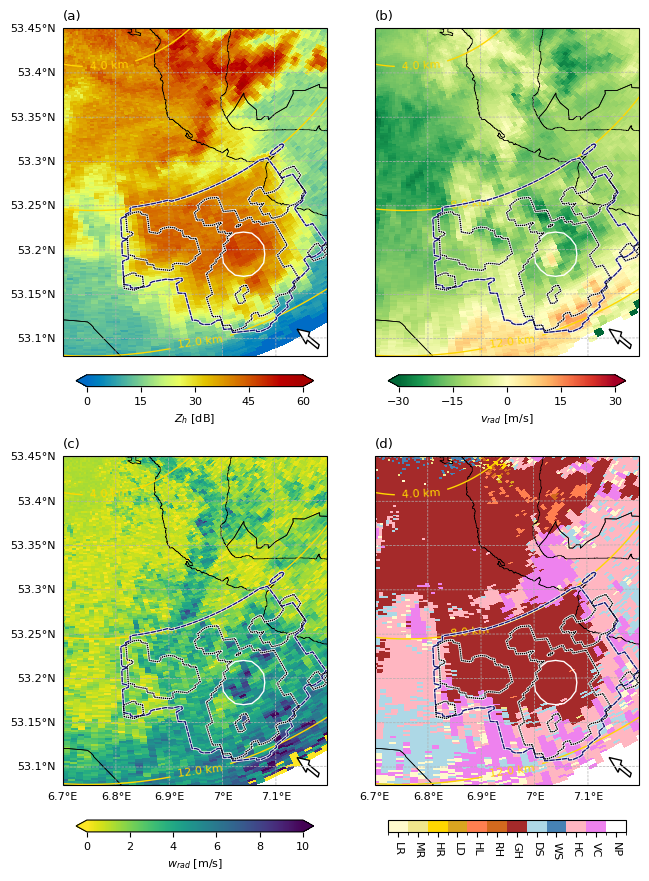

File is saved to: /home/reinaart/sparkles/article_figs_test/topview_dbzh_vrad_wrad_hmc_elev12.png


In [27]:
#%% Plotting
config_, im = plot_RAD_multivar.main(
    config_plot = config_plot,
    config_data_RAD = config_data_RAD,
    config_LOFAR = config_LOFAR,
    config_mask_RADnearVHF = config_mask_RADnearVHF,
    )

# Figure 11: Multi variable, topview cell B at 19:54:24, elevation 17$^\circ$

In [28]:
# Configure plot and data
LOFAR_file = "21C8-all.dat"
image_category = f"cellB_{LOFAR_file[:4]}"
outname = f"{image_category}_multi-var"

vars_RAD=[
    "dbzh",
    "vradh",
    "wradh",
    "hmc"]

plot_extent = WindowExtent(
    x_range=[6.7,7.2],
    y_range=[53.08,53.45],
    )

config_plot = ConfigPlotMultiVarRAD(
    sweep_angle_list=[
        # 0.5
        # 1.5, 
        # 2.5, 
        # 3.5, 
        # 4.5,
        # 5.5,
        # 8, 
        # 12, 
        17, 
        # 25,
        ],
    vars_RAD=vars_RAD,
    plot_extent=plot_extent,
    live_plot=True,
    save=True,
    outdir=f"{outdir}",
    outname="topview_dbzh_vrad_wrad_hmc",
    dirpath_shapefiles_borders=dirpath_shapefiles_borders,
    )

config_data_RAD = ConfigDataRAD(
    RADdata_dirpath, 
    stormcode="21C", 
    VHFtype="sparkles&otherVHF", 
    RADstation="asb", 
    RADvars=vars_RAD,
    advection_reference_filepath=advection_reference_filepath, 
    temp_reference_filepath=advection_reference_filepath,
    hmc_msf_filepath=hmc_msf_filepath,
    epsg=28992,
    )

config_LOFAR = ConfigLOFAR(
    stormcode="21C", 
    LOFAR_file=LOFAR_file,
    datapath = LOFARdata_dirpath,
    sparkle_params = sparkle_params,
    max_distance = 100e3, # radial distance from LOFAR superterm [meter]
    )

config_mask_RADnearVHF = ConfigMaskRADnearVHF(
    RADnearVHF_radius = 2000, # Max distance between radar and VHF data to be matched
    RADalt_threshold=8e3, # Minimum altitude [meter] for radar data to be considered
    RADdbzh_threshold=0, # Minimum dbzh value for radar data to be considered
    )

In [29]:
# Add ellips and arrow annotations
ellipse = PlottingObject(
    obj_type ="ellipse",
    ax_name="all",
    xy = [7.03,53.195],
    width = 0.06,
    height = 0.05,
    kwargs = {
        "transform":PlateCarree(),
        "facecolor":"none",
        "edgecolor":"white",
        "linewidth":1,
        },
    )

arrow = PlottingObject(
    obj_type="arrow",
    ax_name = "all",
    x = 6.98,
    y = 53.15,
    dx = 0,
    dy = 0.01,
    kwargs = {
         "transform":PlateCarree(),
        "facecolor":"white",
        "width":0.005,
        "edgecolor":"k",
        "linewidth":1,
        }
    )

config_plot.list_plotting_objects = [
    ellipse, 
    arrow,
    ]

Transforming window_extent crs: epsg:4326 to +proj=aeqd +lat_0=53.564129 +lon_0=6.748317 +x_0=0 +y_0=0 +datum=WGS84
Filtering LOFAR data for max distance of 100000.0 meter from superterp.
Transforming LOFAR to target crs.
Clustering LOFAR sources to get sparkles
Large-scale clustering with parameters: d=1000 m, t=150 ms, n=30
Sparkle-scale clustering with parameters: d=200 m, t=5 ms, n=2
Filtering altitude variable on [8000, None].
No time window specified, so not filtering on this variable.
No xy_polygons specified, so not filtering for polygons.
Transforming window_extent crs: epsg:4326 to +proj=aeqd +lat_0=53.564129 +lon_0=6.748317 +x_0=0 +y_0=0 +datum=WGS84
Plotting topview_dbzh_vrad_wrad_hmc_elev17.png
Plotting ellipse in axis all.
Plotting ellipse in axis all.
Plotting ellipse in axis all.
Plotting ellipse in axis all.
Plotting arrow in axis all.
Plotting arrow in axis all.
Plotting arrow in axis all.
Plotting arrow in axis all.


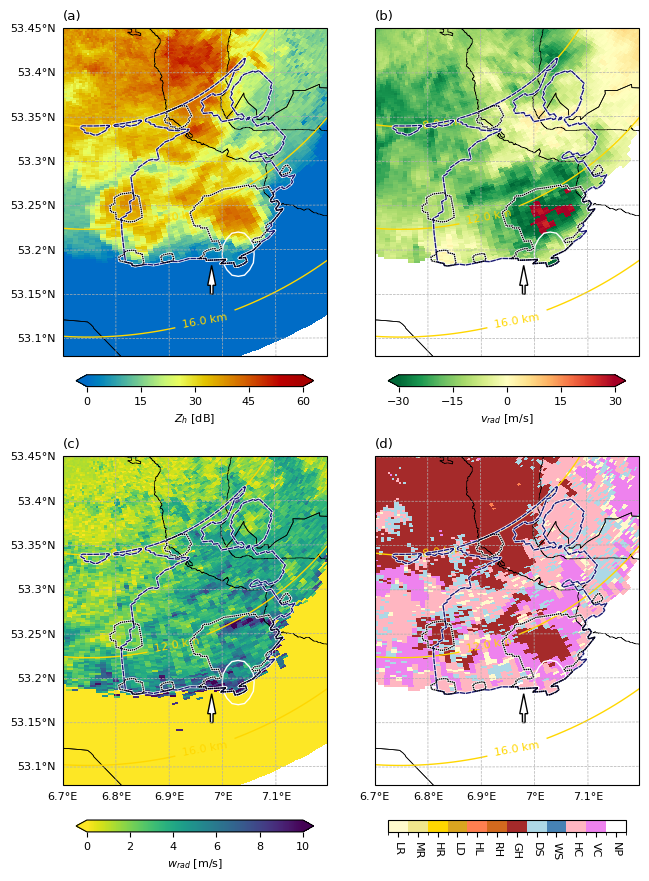

File is saved to: /home/reinaart/sparkles/article_figs_test/topview_dbzh_vrad_wrad_hmc_elev17.png


In [30]:
#%% Plotting
config_, im = plot_RAD_multivar.main(
    config_plot = config_plot,
    config_data_RAD = config_data_RAD,
    config_LOFAR = config_LOFAR,
    config_mask_RADnearVHF = config_mask_RADnearVHF,
    )

# Appendix: Radar data

## Figure: Radar topview cell A at 19:17:37, multi variable, multi elevation

In [31]:
# Configure plot and data
LOFAR_file = "21C6er-all.dat"
image_category = f"cellA_{LOFAR_file[:4]}"
outname = f"{image_category}_multi-var_multi-elev"

vars_RAD=[
    "dbzh",
    "vradh",
    "wradh",
    "hmc"]

plot_extent = WindowExtent(
    x_range=[6.8,7.24],
    y_range=[53.18,53.5],
    )

config_plot = ConfigPlotMultiVarRAD(
    sweep_angle_list=[
        # 0.5
        # 1.5, 
        # 2.5, 
        # 3.5, 
        4.5,
        # 5.5,
        # 8, 
        # 12, 
        17, 
        25,
        ],
    vars_RAD=vars_RAD,
    plot_extent=plot_extent,
    max_nr_panel_cols = 4,
    merge_sweep_angles = True,
    live_plot=True,
    save=True,
    outdir=f"{outdir}",
    outname="topview_dbzh_vrad_wrad_hmc_multi-elev",
    dirpath_shapefiles_borders=dirpath_shapefiles_borders,
    )

config_data_RAD = ConfigDataRAD(
    RADdata_dirpath, 
    stormcode="21C", 
    VHFtype="sparkles&otherVHF", 
    RADstation="asb", 
    RADvars=vars_RAD,
    advection_reference_filepath=advection_reference_filepath, 
    temp_reference_filepath=advection_reference_filepath,
    hmc_msf_filepath=hmc_msf_filepath,
    epsg=28992,
    )

config_LOFAR = ConfigLOFAR(
    stormcode="21C", 
    LOFAR_file=LOFAR_file,
    datapath = LOFARdata_dirpath,
    sparkle_params = sparkle_params,
    max_distance = 100e3, # radial distance from LOFAR superterm [meter]
    )

config_mask_RADnearVHF = ConfigMaskRADnearVHF(
    RADnearVHF_radius = 2000, # Max distance between radar and VHF data to be matched
    RADalt_threshold=8e3, # Minimum altitude [meter] for radar data to be considered
    RADdbzh_threshold=0, # Minimum dbzh value for radar data to be considered
    )

Transforming window_extent crs: epsg:4326 to +proj=aeqd +lat_0=53.564129 +lon_0=6.748317 +x_0=0 +y_0=0 +datum=WGS84
Filtering LOFAR data for max distance of 100000.0 meter from superterp.
Transforming LOFAR to target crs.
Clustering LOFAR sources to get sparkles
Large-scale clustering with parameters: d=1000 m, t=150 ms, n=30
Sparkle-scale clustering with parameters: d=200 m, t=5 ms, n=2
Filtering altitude variable on [8000, None].
No time window specified, so not filtering on this variable.
No xy_polygons specified, so not filtering for polygons.
Transforming window_extent crs: epsg:4326 to +proj=aeqd +lat_0=53.564129 +lon_0=6.748317 +x_0=0 +y_0=0 +datum=WGS84


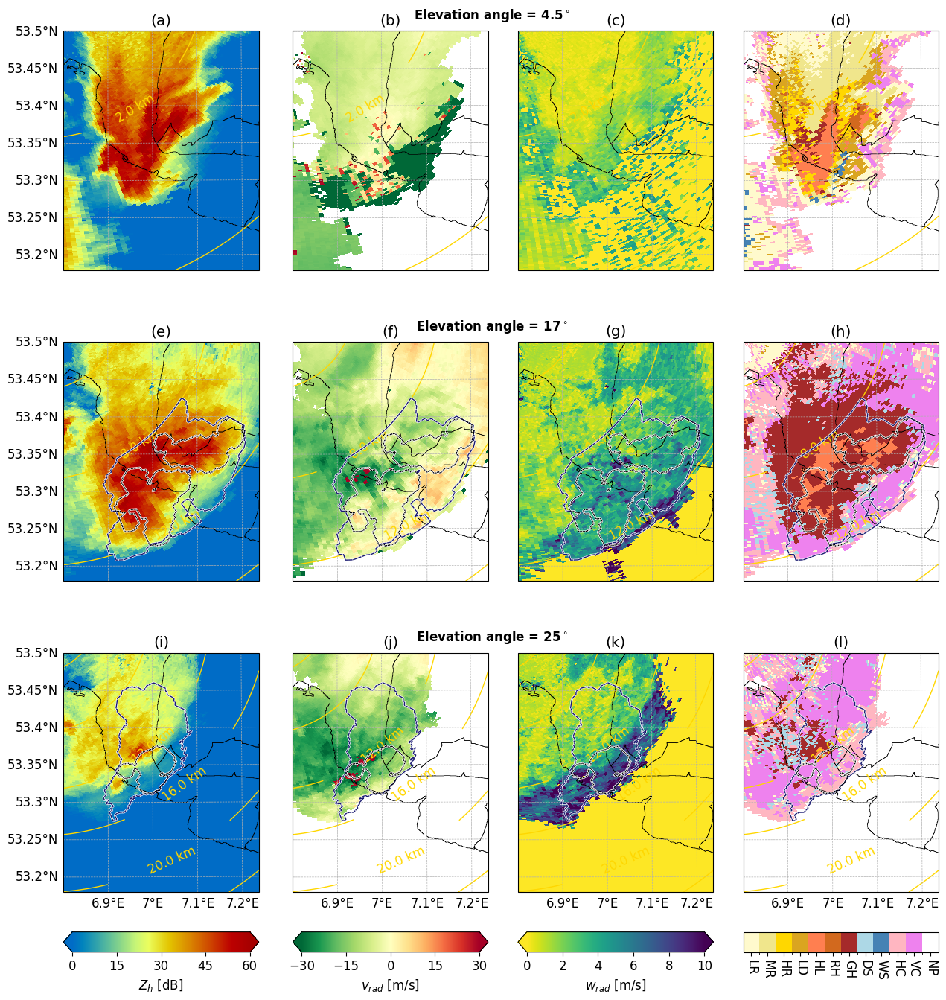

File is saved to: /home/reinaart/sparkles/article_figs_test/topview_dbzh_vrad_wrad_hmc_multi-elev


In [32]:
#%% Plotting
config_, im = plot_RAD_multivar.main(
    config_plot = config_plot,
    config_data_RAD = config_data_RAD,
    config_LOFAR = config_LOFAR,
    config_mask_RADnearVHF = config_mask_RADnearVHF,
    )

In [33]:
## Figure Appendix: Radar topview cell A at 19:54:24, multi variable, multi elevation

In [34]:
# Configure plot and data
LOFAR_file = "21C8-all.dat"
image_category = f"cellB_{LOFAR_file[:4]}"
outname = f"{image_category}_multi-var_multi-elev"

vars_RAD=[
    "dbzh",
    "vradh",
    "wradh",
    "hmc"]

plot_extent = WindowExtent(
    x_range=[6.7,7.2],
    y_range=[53.08,53.45],
    )

config_plot = ConfigPlotMultiVarRAD(
    sweep_angle_list=[
        # 0.5
        1.5, 
        # 2.5, 
        # 3.5, 
        #4.5,
        # 5.5,
        8, 
        12, 
        17, 
        25,
        ],
    vars_RAD=vars_RAD,
    plot_extent=plot_extent,
    max_nr_panel_cols = 4,
    merge_sweep_angles = True,
    live_plot=True,
    save=True,
    outdir=f"{outdir}",
    outname="topview_dbzh_vrad_wrad_hmc_multi-elev",
    dirpath_shapefiles_borders=dirpath_shapefiles_borders,
    )

config_data_RAD = ConfigDataRAD(
    RADdata_dirpath, 
    stormcode="21C", 
    VHFtype="sparkles&otherVHF", 
    RADstation="asb", 
    RADvars=vars_RAD,
    advection_reference_filepath=advection_reference_filepath, 
    temp_reference_filepath=advection_reference_filepath,
    hmc_msf_filepath=hmc_msf_filepath,
    epsg=28992,
    )

config_LOFAR = ConfigLOFAR(
    stormcode="21C", 
    LOFAR_file=LOFAR_file,
    datapath = LOFARdata_dirpath,
    sparkle_params = sparkle_params,
    max_distance = 100e3, # radial distance from LOFAR superterm [meter]
    )

config_mask_RADnearVHF = ConfigMaskRADnearVHF(
    RADnearVHF_radius = 2000, # Max distance between radar and VHF data to be matched
    RADalt_threshold=8e3, # Minimum altitude [meter] for radar data to be considered
    RADdbzh_threshold=0, # Minimum dbzh value for radar data to be considered
    )

Transforming window_extent crs: epsg:4326 to +proj=aeqd +lat_0=53.564129 +lon_0=6.748317 +x_0=0 +y_0=0 +datum=WGS84
Filtering LOFAR data for max distance of 100000.0 meter from superterp.
Transforming LOFAR to target crs.
Clustering LOFAR sources to get sparkles
Large-scale clustering with parameters: d=1000 m, t=150 ms, n=30
Sparkle-scale clustering with parameters: d=200 m, t=5 ms, n=2
Filtering altitude variable on [8000, None].
No time window specified, so not filtering on this variable.
No xy_polygons specified, so not filtering for polygons.
Transforming window_extent crs: epsg:4326 to +proj=aeqd +lat_0=53.564129 +lon_0=6.748317 +x_0=0 +y_0=0 +datum=WGS84


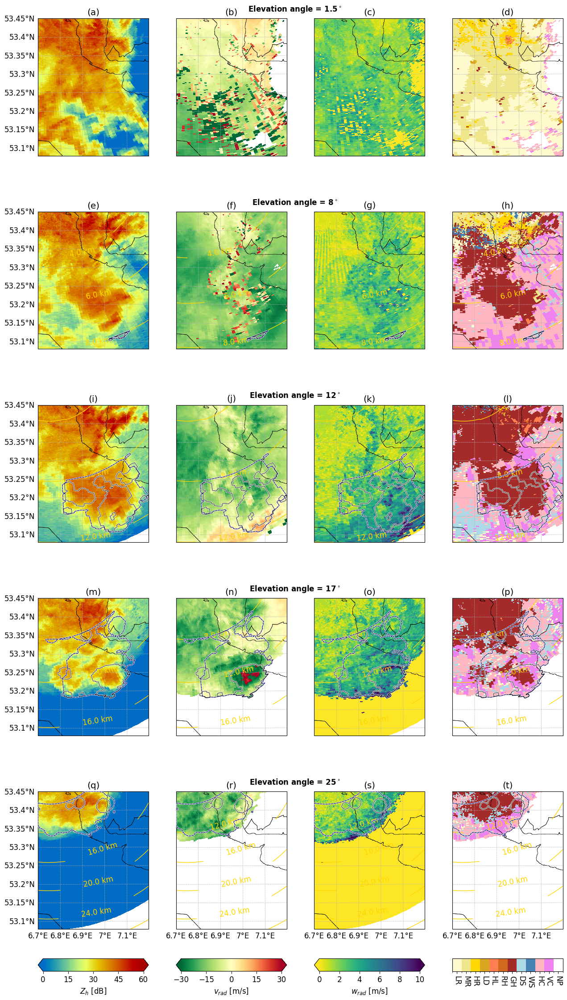

File is saved to: /home/reinaart/sparkles/article_figs_test/topview_dbzh_vrad_wrad_hmc_multi-elev


In [35]:
#%% Plotting
config_, im = plot_RAD_multivar.main(
    config_plot = config_plot,
    config_data_RAD = config_data_RAD,
    config_LOFAR = config_LOFAR,
    config_mask_RADnearVHF = config_mask_RADnearVHF,
    )

# Appendix: LOFAR data

LOFAR data already in the right crs.
Large-scale clustering with parameters: d=1000 m, t=150 ms, n=30
Sparkle-scale clustering with parameters: d=200 m, t=5 ms, n=2
Filtering altitude variable on [8000, None].
No time window specified, so not filtering on this variable.
No xy_polygons specified, so not filtering for polygons.
20377 VHF sources in -90.7616407<t<1986.4477067
20375 VHF sources in 4000.0<z<14500.0
LOFAR data already in the right crs.
Transforming window_extent crs: epsg:4326 to epsg:28992
17845 VHF sources in 249450.80785328156<x<277945.64714952564
17814 VHF sources in 577961.8709836524<y<614234.4489789759
Transforming window_extent crs: epsg:4326 to epsg:28992


/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/.venv/lib/python3.12/site-packages/cartopy/mpl/feature_artist.py:172: UserWarning: Unable to determine extent. Defaulting to global.
  warnings.warn('Unable to determine extent. Defaulting to global.')


File is saved to: /home/reinaart/sparkles/article_figs_test/appendix_LOFAR-21C6_cellA.png


/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/.venv/lib/python3.12/site-packages/cartopy/mpl/feature_artist.py:172: UserWarning: Unable to determine extent. Defaulting to global.
  warnings.warn('Unable to determine extent. Defaulting to global.')
/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/.venv/lib/python3.12/site-packages/cartopy/mpl/feature_artist.py:172: UserWarning: Unable to determine extent. Defaulting to global.
  warnings.warn('Unable to determine extent. Defaulting to global.')


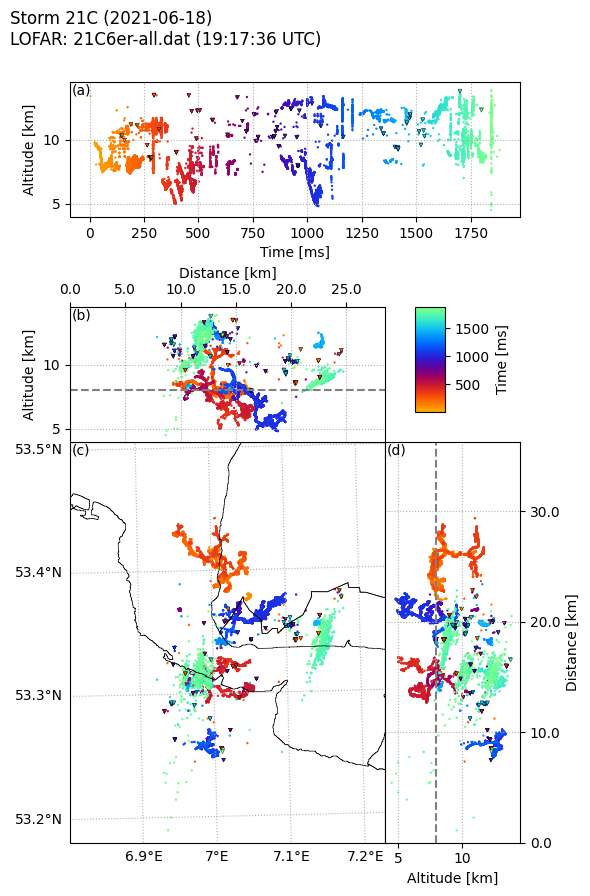

In [36]:
# LOFAR plot: 21C8_cellB
outname = "appendix_LOFAR-21C6_cellA"

plot_extent = WindowExtent(
    x_range=[6.8,7.24],
    y_range=[53.18,53.5],
    z_range=[4e3,14.5e3],
    t_range=[None,None],
    )

config_LOFAR = ConfigLOFAR(
    LOFAR_file="21C6er-all.dat",
    stormcode="21C",
    datapath = LOFARdata_dirpath,
    crs='epsg:28992',
    window_extent=WindowExtent(
        ),
    sparkle_params=sparkle_params,
    )

config_plot_LOFAR = ConfigPlotLOFAR(
    VHF_type="sparkles&otherVHF",
    plot_extent = plot_extent,
    outdir=outdir,
    outname=outname,
    save=True,
    live_plot= True,
    markersize=0.5,
    dirpath_shapefiles_borders=dirpath_shapefiles_borders,
    )

# Plotting
LOFARdata = plot_LOFAR.main(
    config_LOFAR = config_LOFAR, 
    config_plot = config_plot_LOFAR)

LOFAR data already in the right crs.
Large-scale clustering with parameters: d=1000 m, t=150 ms, n=30
Sparkle-scale clustering with parameters: d=200 m, t=5 ms, n=2
Filtering altitude variable on [8000, None].
No time window specified, so not filtering on this variable.
No xy_polygons specified, so not filtering for polygons.
89925 VHF sources in -85.2373927<t<1837.3518187
89739 VHF sources in 3000.0<z<14500.0
LOFAR data already in the right crs.
Transforming window_extent crs: epsg:4326 to epsg:28992
67928 VHF sources in 241748.30855258316<x<269107.4911550599
63661 VHF sources in 560007.5338251739<y<595087.2909680539
Transforming window_extent crs: epsg:4326 to epsg:28992


/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/.venv/lib/python3.12/site-packages/cartopy/mpl/feature_artist.py:172: UserWarning: Unable to determine extent. Defaulting to global.
  warnings.warn('Unable to determine extent. Defaulting to global.')


File is saved to: /home/reinaart/sparkles/article_figs_test/appendix_LOFAR-21C7_cellB.png


/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/.venv/lib/python3.12/site-packages/cartopy/mpl/feature_artist.py:172: UserWarning: Unable to determine extent. Defaulting to global.
  warnings.warn('Unable to determine extent. Defaulting to global.')
/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/.venv/lib/python3.12/site-packages/cartopy/mpl/feature_artist.py:172: UserWarning: Unable to determine extent. Defaulting to global.
  warnings.warn('Unable to determine extent. Defaulting to global.')


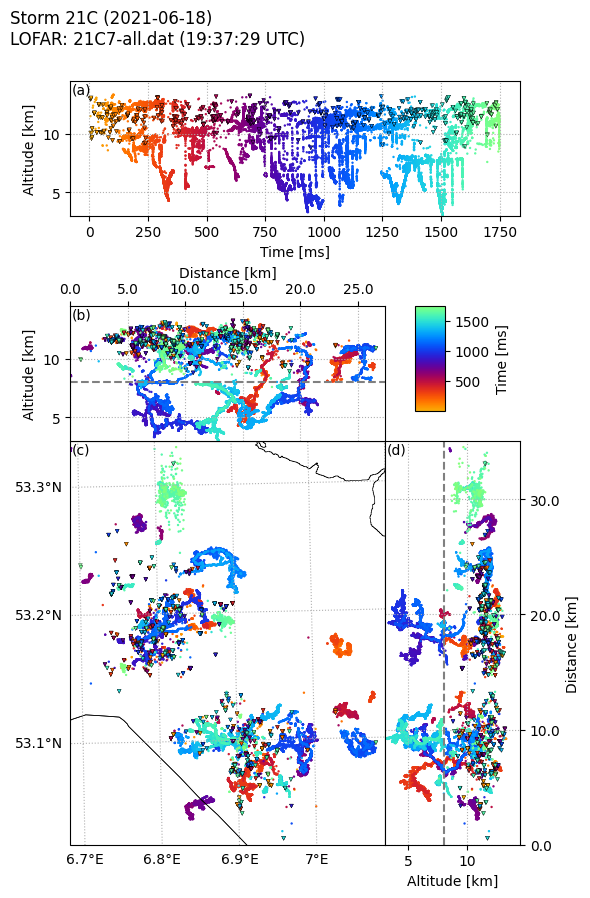

In [37]:
# LOFAR plot: 21C7_cellB
outname = "appendix_LOFAR-21C7_cellB"

plot_extent = WindowExtent(
    x_range=[6.68,7.1],
    y_range=[53.02,53.33],
    z_range=[3e3,14.5e3],
    t_range=[None,None],

    )

config_LOFAR = ConfigLOFAR(
    LOFAR_file="21C7-all.dat",
    stormcode="21C",
    datapath = LOFARdata_dirpath,
    crs='epsg:28992',
    window_extent=WindowExtent(
        ),
    sparkle_params=sparkle_params,
    )

config_plot_LOFAR = ConfigPlotLOFAR(
    VHF_type="sparkles&otherVHF",
    plot_extent = plot_extent,
    outdir=outdir,
    outname=outname,
    save=True,
    live_plot= True,
    markersize=0.5,
    dirpath_shapefiles_borders=dirpath_shapefiles_borders,
    )

# Plotting
LOFARdata = plot_LOFAR.main(
    config_LOFAR = config_LOFAR, 
    config_plot = config_plot_LOFAR)

LOFAR data already in the right crs.
Large-scale clustering with parameters: d=1000 m, t=150 ms, n=30
Sparkle-scale clustering with parameters: d=200 m, t=5 ms, n=2
Filtering altitude variable on [8000, None].
No time window specified, so not filtering on this variable.
No xy_polygons specified, so not filtering for polygons.
120780 VHF sources in -67.38372875<t<1422.01131575
120780 VHF sources in 2500<z<14000
LOFAR data already in the right crs.
Transforming window_extent crs: epsg:4326 to epsg:28992
114307 VHF sources in 250295.0598858568<x<272538.9047894262
82569 VHF sources in 569073.2862239545<y<591050.7426376936
Transforming window_extent crs: epsg:4326 to epsg:28992


/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/.venv/lib/python3.12/site-packages/cartopy/mpl/feature_artist.py:172: UserWarning: Unable to determine extent. Defaulting to global.
  warnings.warn('Unable to determine extent. Defaulting to global.')


File is saved to: /home/reinaart/sparkles/article_figs_test/appendix_LOFAR-21C8_cellB.png


/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/.venv/lib/python3.12/site-packages/cartopy/mpl/feature_artist.py:172: UserWarning: Unable to determine extent. Defaulting to global.
  warnings.warn('Unable to determine extent. Defaulting to global.')
/home/reinaart/sparkles/LOFARsparkles-radar-researchcode/.venv/lib/python3.12/site-packages/cartopy/mpl/feature_artist.py:172: UserWarning: Unable to determine extent. Defaulting to global.
  warnings.warn('Unable to determine extent. Defaulting to global.')


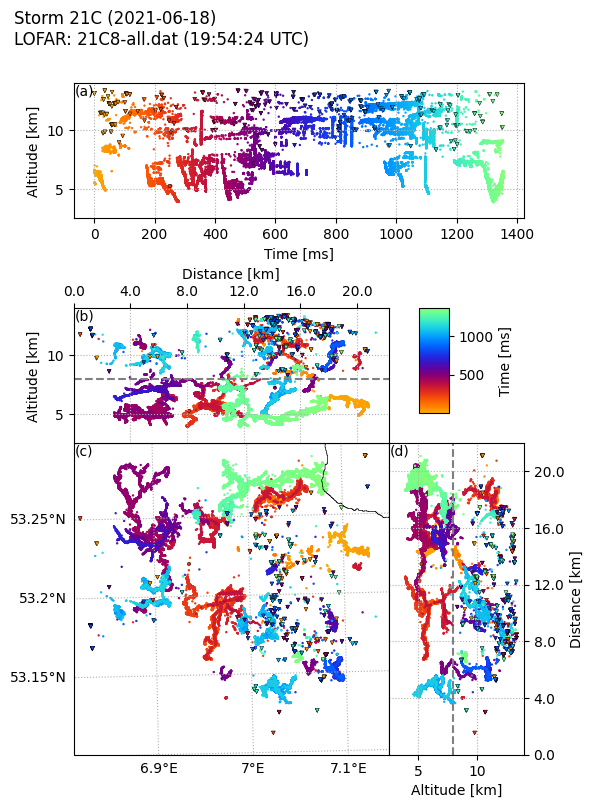

In [38]:
# LOFAR plot: 21C8_cellB
outname = "appendix_LOFAR-21C8_cellB"

plot_extent = WindowExtent(
    x_range=[6.81, 7.15],
    y_range=[53.1, 53.293],
    z_range=[2500,14000],
    t_range=[None,None],
    )

config_LOFAR = ConfigLOFAR(
    LOFAR_file="21C8-all.dat",
    stormcode="21C",
    datapath = LOFARdata_dirpath,
    crs='epsg:28992',
    window_extent=WindowExtent(
        ),
    sparkle_params=sparkle_params,
    )

config_plot_LOFAR = ConfigPlotLOFAR(
    VHF_type="sparkles&otherVHF",
    plot_extent = plot_extent,
    outdir=outdir,
    outname=outname,
    save=True,
    live_plot= True,
    markersize=0.5,
    dirpath_shapefiles_borders=dirpath_shapefiles_borders,
    )

# Plotting
LOFARdata = plot_LOFAR.main(
    config_LOFAR = config_LOFAR, 
    config_plot = config_plot_LOFAR)